# CV Analysis of Blood Plasma

Classical computer vision image analysis (no AI).  
Steps:
1. Auto-ROI via HSV (plasma region segmentation)
2. Brightness and variance
3. Mean RGB/HSV color
4. Histograms
5. Control vs experiment comparison

In [1]:
import json
import cv2
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from scipy import stats as scipy_stats
from skimage.measure import shannon_entropy
from skimage.feature import graycomatrix, graycoprops

DATA_DIR = Path("../data")
PATIENT = "patient-01"

# Load analysis.json
with open(DATA_DIR / PATIENT / "analysis.json") as f:
    analysis = json.load(f)

photos_dir = DATA_DIR / PATIENT / "photos" / "jpg"
print(f"Patient: {analysis['patient_id']}, blood group: {analysis['blood_group']}")
print(f"Photos: {len(analysis['photos'])}")
print(f"Samples: {[s['id'] + ' (' + s['type'] + ')' for s in analysis['protocol']['samples']]}")


Пациент: 01, группа крови: II+
Фото: 13 шт.
Образцы: ['0.1.1 (control)', '0.1.2 (control)', '19.1.1 (sample)', '21.1.1 (sample)']


## 0. EXIF Brightness Normalization

iPhone shoots in auto mode: ISO and shutter speed vary from frame to frame.  
Pixel brightness ~ `real_scene_brightness x ExposureTime x ISO`.  
To compare photos, we divide by `ExposureTime x ISO` -> yielding **normalized brightness** proportional to real scene brightness.

We also filter out photos taken with flash or digital zoom.

In [2]:
from fractions import Fraction

def load_exif_lookup(patient_dir: Path) -> dict:
    """Load metadata.json -> dict[filename] = {exposure, iso, flash, zoom, ev}."""
    meta_path = patient_dir / "metadata.json"
    if not meta_path.exists():
        return {}
    with open(meta_path) as f:
        meta_list = json.load(f)
    
    lookup = {}
    for item in meta_list:
        md = item.get("metadata", {})
        filename = item["filename"]
        
        # ExposureTime: "1/3125" -> float
        exp_str = md.get("exif:ExposureTime", "")
        try:
            exposure = float(Fraction(exp_str))
        except (ValueError, ZeroDivisionError):
            exposure = None
        
        # ISO
        iso_str = md.get("exif:PhotographicSensitivity", "")
        try:
            iso = int(iso_str)
        except ValueError:
            iso = None
        
        # Flash: 9 = fired, 16 = no flash
        flash_str = md.get("exif:Flash", "16")
        flash_fired = flash_str in ("9", "1", "5", "7")
        
        # Zoom: FocalLengthIn35mmFilm > 30 = digital zoom
        focal_str = md.get("exif:FocalLengthIn35mmFilm", "24")
        try:
            focal_35mm = int(focal_str)
        except ValueError:
            focal_35mm = 24
        has_zoom = focal_35mm > 30
        
        # EV (exposure value) = exposure_time * iso
        # Normalization factor: the higher the EV, the brighter the camera captured
        ev = exposure * iso if (exposure and iso) else None
        
        lookup[filename] = {
            "exposure": exposure,
            "iso": iso,
            "flash": flash_fired,
            "zoom": has_zoom,
            "focal_35mm": focal_35mm,
            "ev": ev,
        }
    return lookup


def is_photo_usable(exif: dict) -> bool:
    """Is the photo suitable for analysis? No flash, no zoom, has EXIF."""
    if exif.get("flash"):
        return False
    if exif.get("zoom"):
        return False
    if exif.get("ev") is None:
        return False
    return True


# Test: load EXIF for patient-01
exif_lookup = load_exif_lookup(DATA_DIR / PATIENT)
print(f"EXIF loaded for {len(exif_lookup)} photos\n")

print(f"{'File':<16} {'Expo':>10} {'ISO':>5} {'EV':>10} {'Flash':>8} {'Zoom':>5} {'OK?':>4}")
print("-" * 62)
for fn, ex in exif_lookup.items():
    exp_str = f"1/{int(1/ex['exposure'])}" if ex['exposure'] else "?"
    ev_str = f"{ex['ev']:.4f}" if ex['ev'] else "?"
    ok = "yes" if is_photo_usable(ex) else "NO"
    print(f"{fn:<16} {exp_str:>10} {ex['iso'] or '?':>5} {ev_str:>10} "
          f"{'YES' if ex['flash'] else 'no':>8} {'YES' if ex['zoom'] else 'no':>5} {ok:>4}")


EXIF загружен для 13 фото

Файл                  Экспо   ISO         EV  Вспышка   Зум  ОК?
--------------------------------------------------------------
IMG_3250.HEIC        1/3124    40     0.0128      нет   нет   да
IMG_3251.HEIC        1/4065    40     0.0098      нет   нет   да
IMG_3252.HEIC        1/4065    40     0.0098      нет   нет   да
IMG_3253.HEIC          1/98   100     1.0101      нет   нет   да
IMG_3254.HEIC         1/437    40     0.0915      нет   нет   да
IMG_3255.HEIC          1/98    64     0.6465      нет   нет   да
IMG_3256.HEIC         1/124    40     0.3226      нет   нет   да
IMG_3257.HEIC         1/242    40     0.1646      нет   нет   да
IMG_3258.HEIC         1/100   500     5.0000      нет   нет   да
IMG_3259.HEIC         1/229    40     0.1747      нет   нет   да
IMG_3260.HEIC         1/150    12     0.0800       ДА   нет  НЕТ
IMG_3261.HEIC         1/706    12     0.0170       ДА    ДА  НЕТ
IMG_3262.HEIC         1/100   250     2.5000      нет   нет   да


## 1. Auto-ROI via HSV

Blood plasma is yellowish-green. Segment by Hue (20-40), Saturation (30-255), Value (80-255).  
Parameters below are **initial** -- tune them for your photos.

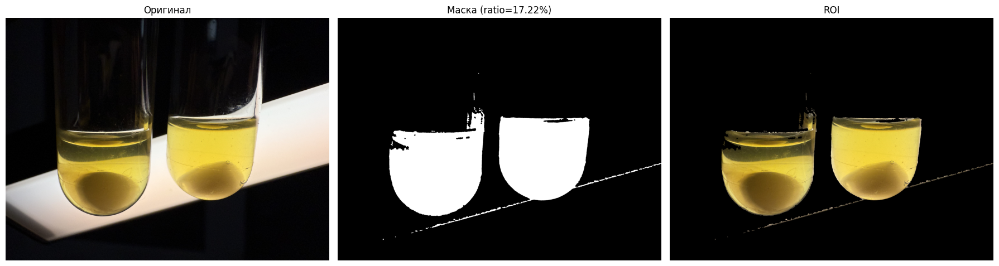

In [3]:
# --- HSV range for plasma (TUNE THESE VALUES) ---
# H: 15-45 (yellow-greenish), S: 60-255 (saturated), V: 60-255 (not too dark)
HSV_LOWER = np.array([15, 60, 60])
HSV_UPPER = np.array([45, 255, 255])

# Minimum pixel fraction in mask (if less -- ROI not found)
MIN_MASK_RATIO = 0.05


def extract_roi_mask(image_bgr: np.ndarray) -> np.ndarray:
    """Create a binary mask of the plasma region using HSV thresholds.
    
    Returns:
        mask: uint8 mask (255 = plasma, 0 = background)
    """
    hsv = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2HSV)
    mask = cv2.inRange(hsv, HSV_LOWER, HSV_UPPER)
    
    # Morphology: remove noise, fill holes
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (7, 7))
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel, iterations=1)
    
    return mask


def get_roi_pixels(image_bgr: np.ndarray, mask: np.ndarray) -> np.ndarray | None:
    """Extract pixels from ROI. Returns None if mask is too small."""
    ratio = np.count_nonzero(mask) / mask.size
    if ratio < MIN_MASK_RATIO:
        return None
    return image_bgr[mask > 0]


# Test on a single photo
test_file = photos_dir / analysis["photos"][0]["filename"].replace(".HEIC", ".jpg")
img = cv2.imread(str(test_file))
mask = extract_roi_mask(img)

# Visualization
fig, axes = plt.subplots(1, 3, figsize=(18, 6))
axes[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
axes[0].set_title("Original")
axes[1].imshow(mask, cmap="gray")
axes[1].set_title(f"Mask (ratio={np.count_nonzero(mask)/mask.size:.2%})")
# Overlay mask on original
overlay = img.copy()
overlay[mask == 0] = [0, 0, 0]
axes[2].imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
axes[2].set_title("ROI")
for ax in axes:
    ax.axis("off")
plt.tight_layout()
plt.show()


### HSV Threshold Tuning

If the mask doesn't capture the plasma or captures too much -- tune `HSV_LOWER` / `HSV_UPPER`.  
The cell below shows the HSV distribution of the photo to help locate the plasma.

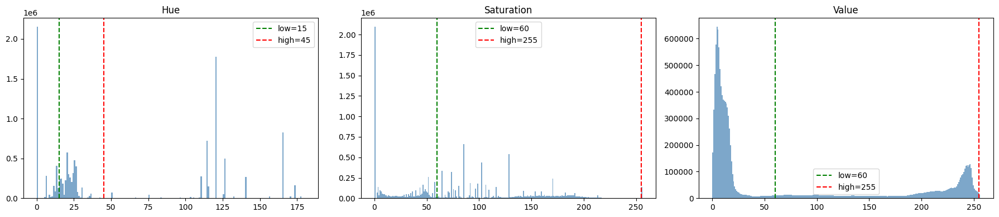

In [4]:
# HSV distribution for threshold tuning
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

fig, axes = plt.subplots(1, 3, figsize=(18, 4))
for i, (ch, name, rng) in enumerate([(0, "Hue", 180), (1, "Saturation", 256), (2, "Value", 256)]):
    axes[i].hist(hsv[:, :, i].ravel(), bins=rng, range=(0, rng), color="steelblue", alpha=0.7)
    axes[i].axvline(HSV_LOWER[i], color="green", linestyle="--", label=f"low={HSV_LOWER[i]}")
    axes[i].axvline(HSV_UPPER[i], color="red", linestyle="--", label=f"high={HSV_UPPER[i]}")
    axes[i].set_title(name)
    axes[i].legend()
plt.tight_layout()
plt.show()


## 1.1 Tube Splitting

Many photos show 2-4 tubes side by side. The HSV mask captures plasma in all of them, but we want **per-tube metrics**.

Algorithm:
1. `cv2.connectedComponentsWithStats` -- find connected regions in the mask
2. Filter small noise by minimum area
3. Determine layout: if centroids are spread more along Y -> horizontal (sort top to bottom), otherwise -> vertical (sort left to right)
4. Match with `samples_shown` from analysis.json by position: tube[0] -> sample[0], tube[1] -> sample[1], ...

Фото: IMG_3253.HEIC
samples_shown: ['19.1.1', '21.1.1', '0.1.1']
Найдено пробирок: 3 (MIN_TUBE_RATIO=0.15)
  #0: area=275,482 px (16% маски), centroid=(1030, 1034)
  #1: area=798,054 px (47% маски), centroid=(1642, 1559)
  #2: area=364,207 px (22% маски), centroid=(2574, 606)

Фото: IMG_3258.HEIC
samples_shown: ['21.1.1', '0.1.1', '19.1.1']
Найдено пробирок: 1
  #0: area=2,011,887 px (94% маски), centroid=(1674, 2910)


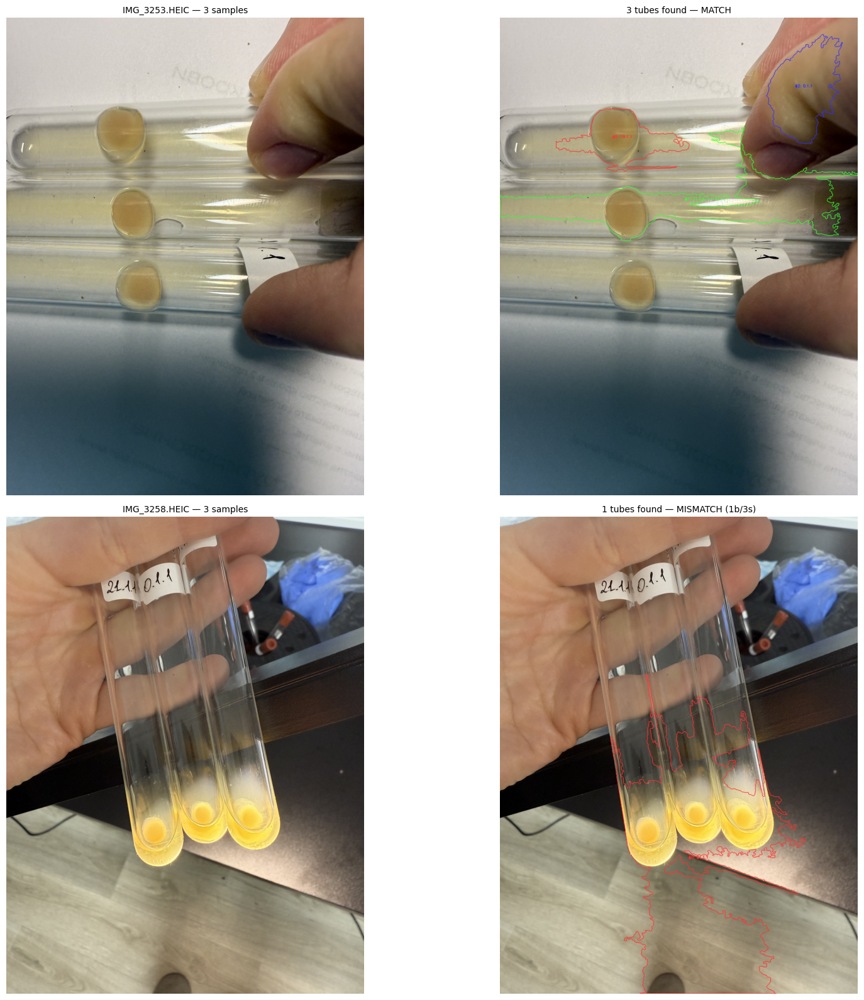

In [5]:
# Blob filtering: a region counts as a tube if >= 15% of the total mask.
# If a photo has 3 tubes of roughly equal size, each is ~33%.
# Small noise (glare, reflections) is usually <5%.
MIN_TUBE_RATIO = 0.15


def split_tubes(mask: np.ndarray) -> list[dict]:
    """Split the combined mask into individual tubes via connected components.
    
    Filtering by relative size: blob must be >= MIN_TUBE_RATIO
    of the total mask area. This is more robust than absolute pixel count.
    
    Returns:
        List of tubes sorted by position:
        - horizontal layout -> top to bottom (by Y)
        - vertical layout -> left to right (by X)
    """
    total_mask_area = np.count_nonzero(mask)
    if total_mask_area == 0:
        return []
    
    n_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(mask, connectivity=8)
    
    tubes = []
    for i in range(1, n_labels):  # 0 = background
        area = stats[i, cv2.CC_STAT_AREA]
        ratio = area / total_mask_area
        if ratio < MIN_TUBE_RATIO:
            continue
        
        tube_mask = np.zeros_like(mask)
        tube_mask[labels == i] = 255
        
        cx, cy = centroids[i]
        x = stats[i, cv2.CC_STAT_LEFT]
        y = stats[i, cv2.CC_STAT_TOP]
        w = stats[i, cv2.CC_STAT_WIDTH]
        h = stats[i, cv2.CC_STAT_HEIGHT]
        
        tubes.append({
            "mask": tube_mask,
            "centroid": (float(cx), float(cy)),
            "area": int(area),
            "ratio": float(ratio),
            "bbox": (int(x), int(y), int(w), int(h)),
        })
    
    if len(tubes) <= 1:
        return tubes
    
    # Layout direction based on centroid spread
    ys = [t["centroid"][1] for t in tubes]
    xs = [t["centroid"][0] for t in tubes]
    y_spread = max(ys) - min(ys)
    x_spread = max(xs) - min(xs)
    
    if y_spread >= x_spread:
        tubes.sort(key=lambda t: t["centroid"][1])  # top to bottom
    else:
        tubes.sort(key=lambda t: t["centroid"][0])  # left to right
    
    return tubes


def get_sample_type(sample_id: str) -> str:
    """0.x.x -> control, otherwise -> sample."""
    return "control" if sample_id.startswith("0.") else "sample"


# --- Test: horizontal tubes (IMG_3253) ---
test_photo = analysis["photos"][3]  # 3 tubes lying parallel
test_file = photos_dir / test_photo["filename"].replace(".HEIC", ".jpg")
test_img = cv2.imread(str(test_file))
test_mask = extract_roi_mask(test_img)
tubes = split_tubes(test_mask)

print(f"Photo: {test_photo['filename']}")
print(f"samples_shown: {test_photo['samples_shown']}")
print(f"Tubes found: {len(tubes)} (MIN_TUBE_RATIO={MIN_TUBE_RATIO})")

for i, tube in enumerate(tubes):
    cx, cy = int(tube["centroid"][0]), int(tube["centroid"][1])
    print(f"  #{i}: area={tube['area']:,} px ({tube['ratio']:.0%} of mask), centroid=({cx}, {cy})")

# --- Test: vertical tubes (IMG_3258) ---
test_photo2 = analysis["photos"][8]  # 3 tubes in hand, vertical
test_file2 = photos_dir / test_photo2["filename"].replace(".HEIC", ".jpg")
test_img2 = cv2.imread(str(test_file2))
test_mask2 = extract_roi_mask(test_img2)
tubes2 = split_tubes(test_mask2)

print(f"\nPhoto: {test_photo2['filename']}")
print(f"samples_shown: {test_photo2['samples_shown']}")
print(f"Tubes found: {len(tubes2)}")

for i, tube in enumerate(tubes2):
    cx, cy = int(tube["centroid"][0]), int(tube["centroid"][1])
    print(f"  #{i}: area={tube['area']:,} px ({tube['ratio']:.0%} of mask), centroid=({cx}, {cy})")

# --- Visualization of both tests ---
COLORS = [(255, 50, 50), (50, 255, 50), (50, 50, 255), (255, 255, 50)]

fig, axes = plt.subplots(2, 2, figsize=(18, 16))

for row, (timg, tmask, ttubes, tphoto) in enumerate([
    (test_img, test_mask, tubes, test_photo),
    (test_img2, test_mask2, tubes2, test_photo2),
]):
    # Original
    axes[row, 0].imshow(cv2.cvtColor(timg, cv2.COLOR_BGR2RGB))
    axes[row, 0].set_title(f"{tphoto['filename']} -- {len(tphoto['samples_shown'])} samples", fontsize=10)
    axes[row, 0].axis("off")
    
    # Colored contours
    colored = cv2.cvtColor(timg, cv2.COLOR_BGR2RGB).copy()
    for i, tube in enumerate(ttubes):
        color = COLORS[i % len(COLORS)]
        contours, _ = cv2.findContours(tube["mask"], cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        cv2.drawContours(colored, contours, -1, color, 4)
        cx, cy = int(tube["centroid"][0]), int(tube["centroid"][1])
        sid = tphoto["samples_shown"][i] if i < len(tphoto["samples_shown"]) else "?"
        cv2.putText(colored, f"#{i}: {sid}", (cx - 80, cy - 20),
                    cv2.FONT_HERSHEY_SIMPLEX, 1.0, color, 3)
    
    match = len(ttubes) == len(tphoto["samples_shown"])
    status = "MATCH" if match else f"MISMATCH ({len(ttubes)}b/{len(tphoto['samples_shown'])}s)"
    axes[row, 1].imshow(colored)
    axes[row, 1].set_title(f"{len(ttubes)} tubes found -- {status}", fontsize=10)
    axes[row, 1].axis("off")

plt.tight_layout()
plt.show()


## 2. ROI Metrics

For each plasma region we compute:
- **Brightness** -- mean/std of grayscale pixels
- **Color** -- mean RGB and HSV
- **Entropy** -- Shannon entropy (measure of disorder: uniform plasma -> low, with clots -> high)
- **Texture (GLCM)** -- contrast, homogeneity, energy, correlation (co-occurrence matrix, 4 directions, 64 gray levels)
- **Edges** -- Canny edge density (fraction of edge pixels in ROI) + contour count

In [6]:
GLCM_LEVELS = 64  # Quantize 256 -> 64 gray levels for GLCM
GLCM_DISTANCES = [1]  # Distance between pixel pairs
GLCM_ANGLES = [0, np.pi/4, np.pi/2, 3*np.pi/4]  # 4 directions
CANNY_LOW = 50
CANNY_HIGH = 150


def compute_metrics(image_bgr: np.ndarray, mask: np.ndarray, ev: float | None = None) -> dict | None:
    """Full set of CV metrics for an ROI."""
    pixels = get_roi_pixels(image_bgr, mask)
    if pixels is None:
        return None
    
    gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)
    gray_roi = gray[mask > 0]
    
    # --- Brightness ---
    brightness_mean = float(gray_roi.mean())
    brightness_std = float(gray_roi.std())
    
    # --- RGB Color ---
    rgb_pixels = pixels[:, ::-1]  # BGR -> RGB
    mean_rgb = rgb_pixels.mean(axis=0).tolist()
    
    # --- HSV Color ---
    hsv_img = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2HSV)
    hsv_roi = hsv_img[mask > 0]
    mean_hsv = hsv_roi.mean(axis=0).tolist()
    
    # --- Entropy (Shannon) ---
    # Compute from ROI pixel histogram, not from the entire image
    hist, _ = np.histogram(gray_roi, bins=256, range=(0, 256))
    hist = hist[hist > 0]  # remove zeros
    probs = hist / hist.sum()
    entropy = float(-np.sum(probs * np.log2(probs)))
    
    # --- GLCM Texture ---
    # Crop to mask bounding box for 2D operations
    ys, xs = np.where(mask > 0)
    y0, y1 = ys.min(), ys.max() + 1
    x0, x1 = xs.min(), xs.max() + 1
    gray_crop = gray[y0:y1, x0:x1]
    mask_crop = mask[y0:y1, x0:x1]
    
    # Quantize and zero out background
    gray_q = (gray_crop // (256 // GLCM_LEVELS)).astype(np.uint8)
    gray_q[mask_crop == 0] = 0
    
    glcm = graycomatrix(gray_q, distances=GLCM_DISTANCES, angles=GLCM_ANGLES,
                        levels=GLCM_LEVELS, symmetric=True, normed=True)
    
    # Average across 4 directions
    contrast = float(graycoprops(glcm, 'contrast').mean())
    homogeneity = float(graycoprops(glcm, 'homogeneity').mean())
    energy = float(graycoprops(glcm, 'energy').mean())
    correlation = float(graycoprops(glcm, 'correlation').mean())
    
    # --- Canny edges ---
    edges = cv2.Canny(gray, CANNY_LOW, CANNY_HIGH)
    edges_roi = edges[mask > 0]
    roi_pixels_count = np.count_nonzero(mask)
    edge_density = float(np.count_nonzero(edges_roi) / roi_pixels_count)
    
    # Contours within ROI (clots, objects)
    edges_masked = cv2.bitwise_and(edges, mask)
    contours, _ = cv2.findContours(edges_masked, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    # Filter small contours (noise)
    min_contour_area = roi_pixels_count * 0.001  # 0.1% of ROI
    significant_contours = [c for c in contours if cv2.contourArea(c) >= min_contour_area]
    n_contours = len(significant_contours)
    
    result = {
        "brightness_mean": brightness_mean,
        "brightness_std": brightness_std,
        "rgb_mean": mean_rgb,
        "hsv_mean": mean_hsv,
        "roi_ratio": float(roi_pixels_count / mask.size),
        "entropy": entropy,
        "glcm_contrast": contrast,
        "glcm_homogeneity": homogeneity,
        "glcm_energy": energy,
        "glcm_correlation": correlation,
        "edge_density": edge_density,
        "n_contours": n_contours,
    }
    
    if ev and ev > 0:
        result["brightness_norm"] = float(brightness_mean / ev)
        result["ev"] = ev
    
    return result


# Test on a single photo
exif_test = exif_lookup.get(analysis["photos"][0]["filename"], {})
m = compute_metrics(img, mask, ev=exif_test.get("ev"))
if m:
    print(f"Brightness:  {m['brightness_mean']:.1f} +/- {m['brightness_std']:.1f}")
    print(f"RGB:         ({m['rgb_mean'][0]:.0f}, {m['rgb_mean'][1]:.0f}, {m['rgb_mean'][2]:.0f})")
    print(f"HSV:         (H={m['hsv_mean'][0]:.0f}, S={m['hsv_mean'][1]:.0f}, V={m['hsv_mean'][2]:.0f})")
    print(f"Entropy:     {m['entropy']:.2f} bits")
    print(f"GLCM:        contrast={m['glcm_contrast']:.1f}, homogeneity={m['glcm_homogeneity']:.3f}, "
          f"energy={m['glcm_energy']:.3f}, correlation={m['glcm_correlation']:.3f}")
    print(f"Edges:       density={m['edge_density']:.3f}, contours={m['n_contours']}")
    print(f"ROI:         {m['roi_ratio']:.1%}")


Яркость:     145.7 +/- 54.1
RGB:         (172, 149, 62)
HSV:         (H=23, S=162, V=172)
Энтропия:    7.18 бит
GLCM:        contrast=2.4, homogeneity=0.944, energy=0.710, correlation=0.996
Edges:       density=0.014, контуров=0
ROI:         17.2%


## 3. Batch -- All Patient Photos

In [7]:
def analyze_patient(patient_dir: Path, filter_exif: bool = True) -> list[dict]:
    """Analyze all photos of a single patient with tube splitting.
    
    Returns a list of per-sample results (not per-photo!).
    If a photo has N tubes and N samples_shown -- there will be N records.
    If split doesn't match samples_shown -- fallback to whole-photo metrics.
    """
    with open(patient_dir / "analysis.json") as f:
        data = json.load(f)
    
    # Mapping sample_id -> type from protocol
    sample_types = {}
    for s in data.get("protocol", {}).get("samples", []):
        sample_types[s["id"]] = s["type"]
    
    exif = load_exif_lookup(patient_dir)
    results = []
    skipped = 0
    split_stats = {"split": 0, "single": 0, "mismatch": 0}
    jpg_dir = patient_dir / "photos" / "jpg"
    
    for photo in data["photos"]:
        filename = photo["filename"]
        jpg_path = jpg_dir / filename.replace(".HEIC", ".jpg")
        if not jpg_path.exists():
            continue
        
        photo_exif = exif.get(filename, {})
        if filter_exif and not is_photo_usable(photo_exif):
            skipped += 1
            continue
        
        img = cv2.imread(str(jpg_path))
        mask = extract_roi_mask(img)
        ev = photo_exif.get("ev")
        samples_shown = photo.get("samples_shown", [])
        
        tubes = split_tubes(mask)
        n_tubes = len(tubes)
        n_samples = len(samples_shown)
        
        if n_tubes > 1 and n_tubes == n_samples:
            split_stats["split"] += 1
            for i, tube in enumerate(tubes):
                sample_id = samples_shown[i]
                metrics = compute_metrics(img, tube["mask"], ev=ev)
                results.append({
                    "filename": filename,
                    "sample_id": sample_id,
                    "sample_type": sample_types.get(sample_id, get_sample_type(sample_id)),
                    "source": "split",
                    "tube_index": i,
                    "metrics": metrics,
                    "exif": photo_exif,
                })
        elif n_samples == 1:
            split_stats["single"] += 1
            sample_id = samples_shown[0]
            metrics = compute_metrics(img, mask, ev=ev)
            results.append({
                "filename": filename,
                "sample_id": sample_id,
                "sample_type": sample_types.get(sample_id, get_sample_type(sample_id)),
                "source": "single",
                "tube_index": 0,
                "metrics": metrics,
                "exif": photo_exif,
            })
        else:
            split_stats["mismatch"] += 1
            metrics = compute_metrics(img, mask, ev=ev)
            results.append({
                "filename": filename,
                "sample_id": None,
                "sample_type": "unsplit",
                "source": f"mismatch({n_tubes}b/{n_samples}s)",
                "tube_index": None,
                "metrics": metrics,
                "exif": photo_exif,
            })
    
    if skipped:
        print(f"  EXIF filter: skipped {skipped}")
    print(f"  Split: {split_stats['split']} separated, "
          f"{split_stats['single']} single, "
          f"{split_stats['mismatch']} mismatch")
    return results


results = analyze_patient(DATA_DIR / PATIENT)
n_with = sum(1 for r in results if r["metrics"])
print(f"\nTotal: {len(results)} records, with metrics: {n_with}")

# Table with metrics
hdr = f"{'File':<16} {'Sid':<7} {'Type':<7} {'Src':<7} {'Brt':>5} {'Ent':>5} {'Ctr':>5} {'Hom':>5} {'Edge':>5} {'#C':>3}"
print(f"\n{hdr}")
print("-" * len(hdr))
for r in results:
    m = r["metrics"]
    sid = (r["sample_id"] or "n/a")[:7]
    if m:
        print(f"{r['filename']:<16} {sid:<7} {r['sample_type']:<7} {r['source']:<7} "
              f"{m['brightness_mean']:>5.0f} {m['entropy']:>5.2f} {m['glcm_contrast']:>5.1f} "
              f"{m['glcm_homogeneity']:>5.3f} {m['edge_density']:>5.3f} {m['n_contours']:>3}")
    else:
        print(f"{r['filename']:<16} {sid:<7} {r['sample_type']:<7} {r['source']:<7}  -- no ROI --")


  EXIF-фильтр: пропущено 2
  Split: 5 разделены, 2 одиночных, 4 mismatch

Всего: 21 записей, с метриками: 11

Файл             Sid     Тип     Src       Ярк  Энтр   Ctr   Hom  Edge  #C
--------------------------------------------------------------------------
IMG_3250.HEIC    19.1.1  sample  split     123  7.28   4.0 0.855 0.015   0
IMG_3250.HEIC    21.1.1  sample  split     172  6.53   6.0 0.880 0.012   0
IMG_3251.HEIC    21.1.1  sample  single    139  7.11   1.9 0.924 0.003   0
IMG_3252.HEIC    19.1.1  sample  single    139  6.84   0.9 0.948 0.001   0
IMG_3253.HEIC    19.1.1  sample  split    -- нет ROI --
IMG_3253.HEIC    21.1.1  sample  split     141  7.02   4.6 0.929 0.007   0
IMG_3253.HEIC    0.1.1   control split    -- нет ROI --
IMG_3254.HEIC    n/a     unsplit mismatch(3b/4s)   128  7.02   7.2 0.940 0.017   0
IMG_3255.HEIC    21.1.1  sample  split    -- нет ROI --
IMG_3255.HEIC    19.1.1  sample  split    -- нет ROI --
IMG_3255.HEIC    0.1.1   control split    -- нет ROI --
IM

## 3.1 ROI Overview -- All Photos of All Patients

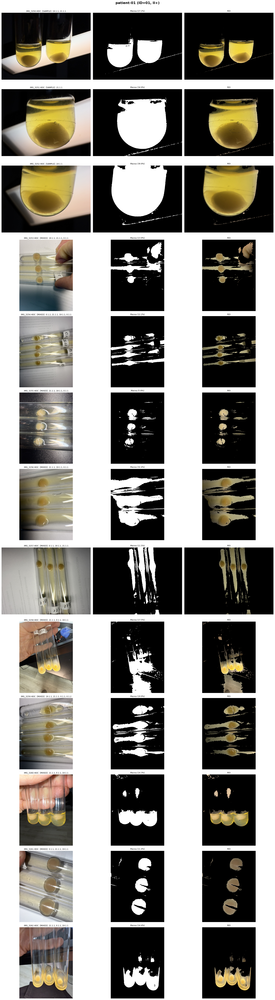

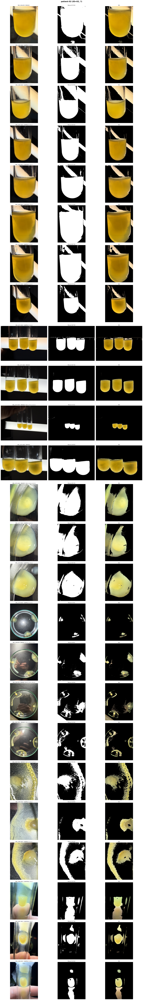

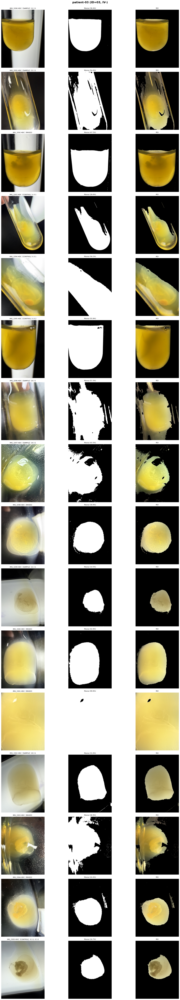

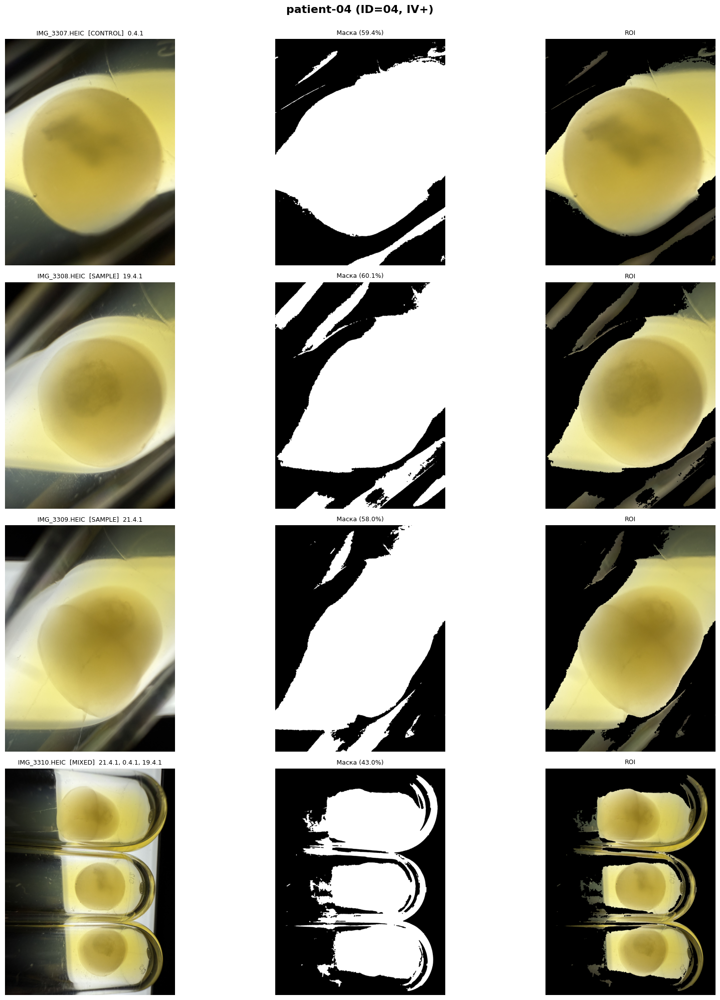

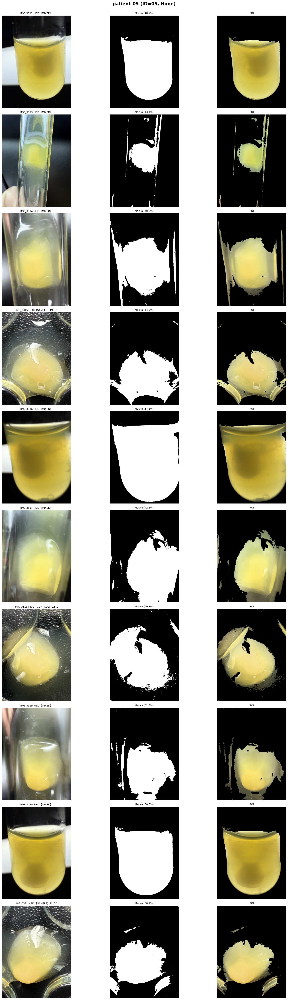

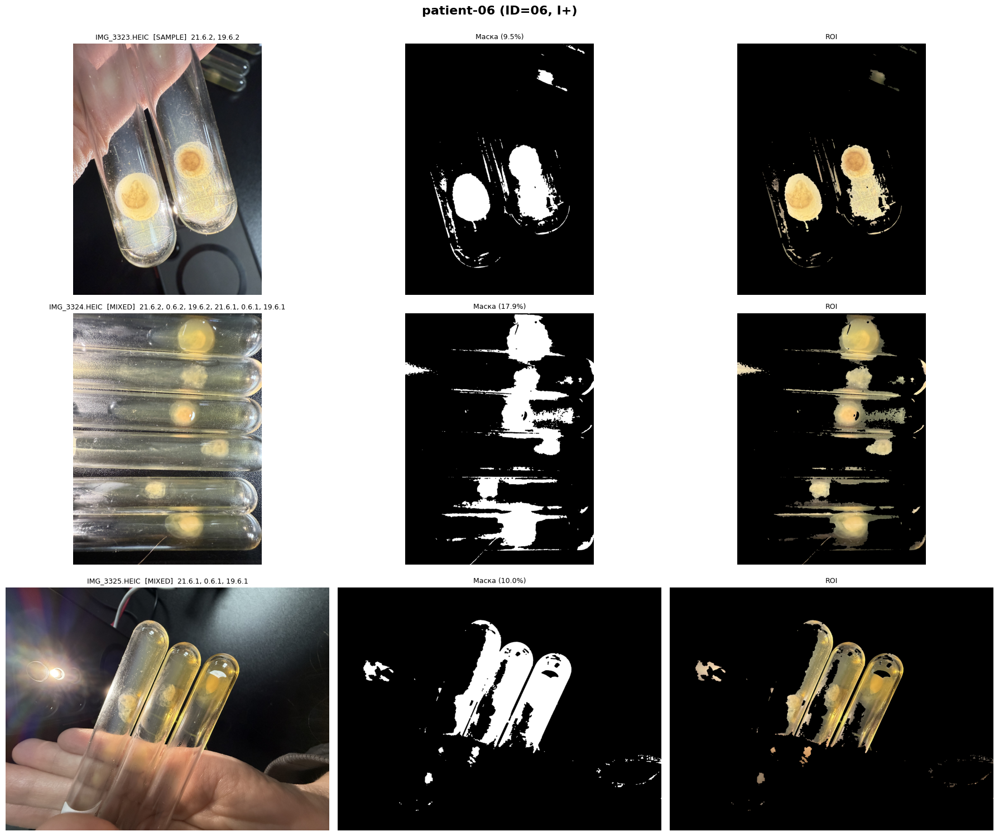

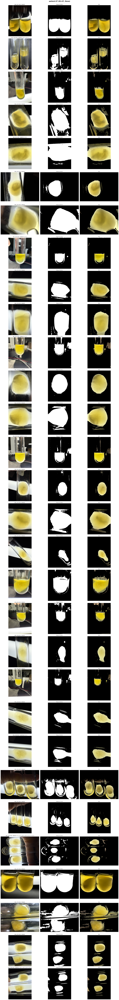

In [8]:
for patient_dir in sorted(DATA_DIR.iterdir()):
    if not patient_dir.is_dir() or not (patient_dir / "analysis.json").exists():
        continue

    patient_name = patient_dir.name
    jpg_dir = patient_dir / "photos" / "jpg"
    with open(patient_dir / "analysis.json") as f:
        data = json.load(f)

    photos = data["photos"]
    n = len(photos)
    if n == 0:
        continue

    # 3 columns: original, mask, ROI overlay
    fig, axes = plt.subplots(n, 3, figsize=(18, 5 * n))
    if n == 1:
        axes = axes[np.newaxis, :]
    fig.suptitle(f"{patient_name} (ID={data.get('patient_id', '?')}, {data.get('blood_group', '?')})",
                 fontsize=16, fontweight="bold", y=1.0)

    for i, photo in enumerate(photos):
        jpg_path = jpg_dir / photo["filename"].replace(".HEIC", ".jpg")
        if not jpg_path.exists():
            for j in range(3):
                axes[i, j].text(0.5, 0.5, "FILE NOT FOUND", ha="center", va="center")
                axes[i, j].axis("off")
            continue

        img = cv2.imread(str(jpg_path))
        mask = extract_roi_mask(img)
        ratio = np.count_nonzero(mask) / mask.size

        overlay = img.copy()
        overlay[mask == 0] = [0, 0, 0]

        # Determine type
        samples = photo.get("samples_shown", [])
        channels = set()
        for s in samples:
            parts = s.split(".")
            if parts:
                try:
                    channels.add(int(parts[0]))
                except ValueError:
                    pass
        if channels == {0}:
            stype = "CONTROL"
        elif channels and 0 not in channels:
            stype = "SAMPLE"
        else:
            stype = "MIXED"

        label = f"{photo['filename']}  [{stype}]  {', '.join(samples)}"

        axes[i, 0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        axes[i, 0].set_title(label, fontsize=9)
        axes[i, 0].axis("off")

        axes[i, 1].imshow(mask, cmap="gray")
        axes[i, 1].set_title(f"Mask ({ratio:.1%})", fontsize=9)
        axes[i, 1].axis("off")

        axes[i, 2].imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
        axes[i, 2].set_title("ROI", fontsize=9)
        axes[i, 2].axis("off")

    plt.tight_layout()
    plt.show()
    print()


## 4. Control vs Experiment Comparison

In [9]:
SCALAR_METRICS = [
    "brightness_mean", "brightness_std", "entropy",
    "glcm_contrast", "glcm_homogeneity", "glcm_energy", "glcm_correlation",
    "edge_density", "n_contours", "roi_ratio",
]


def compare_control_vs_sample(results: list[dict]) -> dict | None:
    """Compare control vs sample: means, delta, Mann-Whitney U p-value."""
    control = [r["metrics"] for r in results if r["sample_type"] == "control" and r["metrics"]]
    sample = [r["metrics"] for r in results if r["sample_type"] == "sample" and r["metrics"]]
    
    if not control or not sample:
        return None
    
    comparison = {}
    for key in SCALAR_METRICS:
        c_vals = [m[key] for m in control if key in m]
        s_vals = [m[key] for m in sample if key in m]
        if not c_vals or not s_vals:
            continue
        
        c_mean = float(np.mean(c_vals))
        s_mean = float(np.mean(s_vals))
        delta = s_mean - c_mean
        pct = (delta / c_mean * 100) if c_mean != 0 else 0
        
        # Mann-Whitney U test (non-parametric, works on small samples)
        p_value = None
        if len(c_vals) >= 2 and len(s_vals) >= 2:
            try:
                _, p_value = scipy_stats.mannwhitneyu(c_vals, s_vals, alternative='two-sided')
                p_value = float(p_value)
            except ValueError:
                pass
        
        comparison[key] = {
            "control": c_mean, "sample": s_mean,
            "delta": delta, "delta_pct": pct,
            "p_value": p_value,
            "n_control": len(c_vals), "n_sample": len(s_vals),
        }
    
    return comparison


comp = compare_control_vs_sample(results)
if comp:
    n_ctrl = sum(1 for r in results if r["sample_type"] == "control" and r["metrics"])
    n_samp = sum(1 for r in results if r["sample_type"] == "sample" and r["metrics"])
    print(f"Control: {n_ctrl}, Sample: {n_samp}\n")
    
    print(f"{'Metric':<22} {'Control':>9} {'Sample':>9} {'Delta':>9} {'%':>7} {'p-value':>8}")
    print("-" * 68)
    for key, v in comp.items():
        p_str = f"{v['p_value']:.3f}" if v['p_value'] is not None else "  n/a"
        sig = " *" if v['p_value'] is not None and v['p_value'] < 0.05 else ""
        print(f"{key:<22} {v['control']:>9.2f} {v['sample']:>9.2f} "
              f"{v['delta']:>+9.2f} {v['delta_pct']:>+6.1f}% {p_str:>8}{sig}")
else:
    n_ctrl = sum(1 for r in results if r["sample_type"] == "control" and r["metrics"])
    n_samp = sum(1 for r in results if r["sample_type"] == "sample" and r["metrics"])
    print(f"Insufficient data: control={n_ctrl}, sample={n_samp}")


Control: 1, Sample: 6

Метрика                  Control    Sample     Delta       %  p-value
--------------------------------------------------------------------
brightness_mean           117.92    140.77    +22.85  +19.4%      n/a
brightness_std             27.27     41.93    +14.66  +53.8%      n/a
entropy                     6.71      6.86     +0.15   +2.3%      n/a
glcm_contrast               5.61      3.91     -1.70  -30.3%      n/a
glcm_homogeneity            0.92      0.91     -0.01   -1.1%      n/a
glcm_energy                 0.59      0.50     -0.09  -16.0%      n/a
glcm_correlation            0.99      0.99     +0.01   +0.6%      n/a
edge_density                0.01      0.01     +0.00   +7.1%      n/a
n_contours                  0.00      0.00     +0.00   +0.0%      n/a
roi_ratio                   0.05      0.17     +0.12 +225.4%      n/a


## 5. Visualization

RGB histograms for control vs sample.

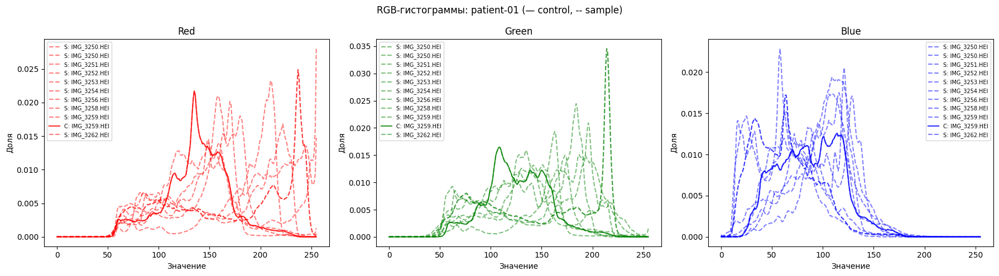

In [10]:
def plot_rgb_histograms(results: list[dict]):
    """RGB histograms for control vs sample."""
    fig, axes = plt.subplots(1, 3, figsize=(18, 5))
    colors = ["red", "green", "blue"]
    channel_names = ["Red", "Green", "Blue"]
    
    for r in results:
        if not r["metrics"]:
            continue
        
        jpg_path = photos_dir / r["filename"].replace(".HEIC", ".jpg")
        img = cv2.imread(str(jpg_path))
        mask = extract_roi_mask(img)
        pixels = get_roi_pixels(img, mask)
        if pixels is None:
            continue
        
        style = "-" if r["sample_type"] == "control" else "--"
        alpha = 0.8 if r["sample_type"] == "control" else 0.5
        label_prefix = "C" if r["sample_type"] == "control" else "S"
        
        rgb_pixels = pixels[:, ::-1]  # BGR -> RGB
        for i in range(3):
            hist, bins = np.histogram(rgb_pixels[:, i], bins=256, range=(0, 256))
            hist = hist / hist.sum()  # normalize
            axes[i].plot(bins[:-1], hist, style, color=colors[i], alpha=alpha,
                        label=f"{label_prefix}: {r['filename'][:12]}")
    
    for i in range(3):
        axes[i].set_title(channel_names[i])
        axes[i].set_xlabel("Value")
        axes[i].set_ylabel("Fraction")
        axes[i].legend(fontsize=7)
    
    plt.suptitle(f"RGB Histograms: {PATIENT} (-- control, -- sample)")
    plt.tight_layout()
    plt.show()


plot_rgb_histograms(results)


## 6. All Patients

Once HSV thresholds are tuned -- run across all 7.

In [11]:
all_comparisons = {}

for patient_dir in sorted(DATA_DIR.iterdir()):
    if not patient_dir.is_dir() or not (patient_dir / "analysis.json").exists():
        continue
    
    patient_name = patient_dir.name
    patient_results = analyze_patient(patient_dir)
    comp = compare_control_vs_sample(patient_results)
    
    with_roi = sum(1 for r in patient_results if r["metrics"])
    print(f"{patient_name}: {len(patient_results)} photos, ROI found in {with_roi}")
    
    if comp:
        all_comparisons[patient_name] = comp

print(f"\nComparison available for {len(all_comparisons)} of 7 patients")


  EXIF-фильтр: пропущено 2
  Split: 5 разделены, 2 одиночных, 4 mismatch
patient-01: 21 фото, ROI найден в 11
  EXIF-фильтр: пропущено 6
  Split: 1 разделены, 13 одиночных, 5 mismatch
patient-02: 21 фото, ROI найден в 17
  EXIF-фильтр: пропущено 1
  Split: 0 разделены, 9 одиночных, 6 mismatch
patient-03: 15 фото, ROI найден в 15
  Split: 0 разделены, 3 одиночных, 1 mismatch
patient-04: 4 фото, ROI найден в 4
  EXIF-фильтр: пропущено 3
  Split: 0 разделены, 0 одиночных, 7 mismatch
patient-05: 7 фото, ROI найден в 7
  Split: 1 разделены, 0 одиночных, 2 mismatch
patient-06: 4 фото, ROI найден в 2
  Split: 1 разделены, 6 одиночных, 23 mismatch
patient-07: 31 фото, ROI найден в 31

Сравнение доступно для 5 из 7 пациентов


---

## TODO

- [x] Auto-ROI via HSV
- [x] Tube splitting (connected components)
- [x] Brightness and variance (#21)
- [x] RGB/HSV distributions (#22)
- [x] Entropy (Shannon) (#23)
- [x] GLCM texture features (#24)
- [x] Canny edge density + contours (#25)
- [x] Control vs sample comparison + Mann-Whitney (#26)
- [ ] Tune HSV thresholds for all photo types (LED, side view, dark background)
- [ ] Save results to JSON/CSV
- [ ] Port working code to asrp.science-llm as API endpoint